In [ ]:
#@title Cargado de archivos y bibliotecas
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import pandas as pd
from scipy.integrate import cumulative_trapezoid
from scipy.integrate import cumtrapz
from scipy.signal import butter, filtfilt
import os
import re

file_id = '1TEzwIYD5qcATxync7wMO1fk8WlV5nOQY'
zip_filename = "felicidadp2.zip"

# Verificar si el archivo ya existe antes de descargarlo
if not os.path.exists(zip_filename):
    !gdown --id {file_id}
else:
    print(f"El archivo '{zip_filename}' ya existe. No se descargará nuevamente.")

# Verificar si la carpeta ya existe antes de descomprimir
extract_folder = "felicidadp2"

if not os.path.exists(extract_folder):
    !unzip {zip_filename}
else:
    print(f"La carpeta '{extract_folder}' ya existe. No se extraerá nuevamente.")

/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1TEzwIYD5qcATxync7wMO1fk8WlV5nOQY
From (redirected): https://drive.google.com/uc?id=1TEzwIYD5qcATxync7wMO1fk8WlV5nOQY&confirm=t&uuid=0a194c59-ae54-42a7-946b-b68b267c15e9
To: /content/felicidadp2.zip
100% 63.6M/63.6M [00:00<00:00, 70.3MB/s]
Archive:  felicidadp2.zip
  inflating: felicidadp2/Medicion_nitrogeno2249.csv  
  inflating: felicidadp2/Medicion_nitrogeno2221.csv  
  inflating: felicidadp2/Medicion_nitrogeno2224.csv  
  inflating: felicidadp2/Medicion_nitrogeno2237.csv  
  inflating: felicidadp2/Medicion_nitrogeno2241.csv  
  inflating: felicidadp2/Medicion_nitrogeno2228.csv  
  inflating: felicidadp2/Medicion_nitrogeno2242.csv  
  inflating: felicidadp2/Medicion_nitrogeno2234.csv  
  inflating: felic

In [ ]:
#@title Ordena numericamente
folder_name = '/content/felicidadp2'

csv_files = [file for file in os.listdir(folder_name) if file.endswith('.csv')]


def extract_number(file_name):
    # Buscar el patrón 'Medicion_nitrogeno2' y extraer el número después
    match = re.search(r'Medicion_nitrogeno2\s*(\d+)', file_name)
    return int(match.group(1)) if match else float('inf')

# Ordenar los archivos numéricamente utilizando la función de extracción
csv_files_sorted = sorted(csv_files, key=extract_number)


dataframes = {}
for csv_file in csv_files_sorted:
    file_path = os.path.join(folder_name, csv_file)
    df = pd.read_csv(file_path)
    dataframes[csv_file] = df


"""
print("Archivos CSV cargados (ordenados numéricamente):")
for name in dataframes.keys():
    print(name)
"""

'\nprint("Archivos CSV cargados (ordenados numéricamente):")\nfor name in dataframes.keys():\n    print(name)\n'

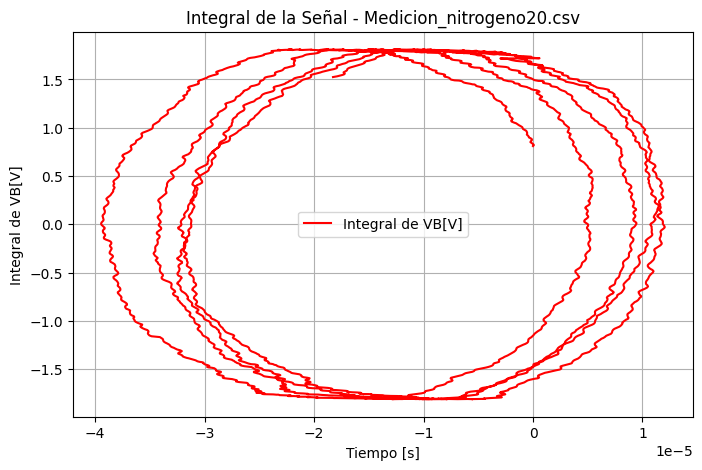

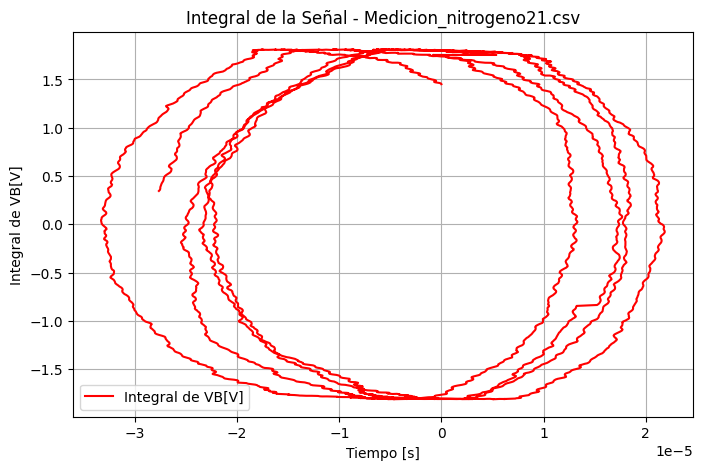

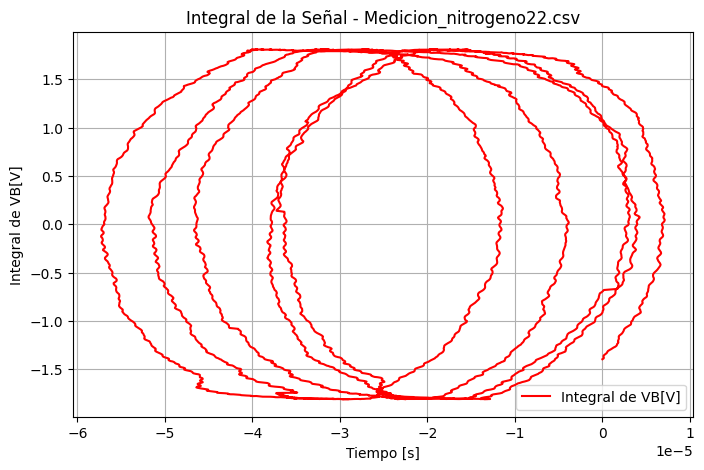

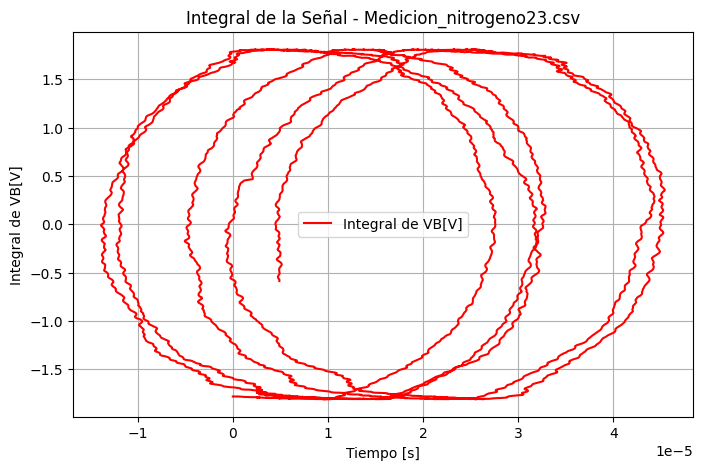

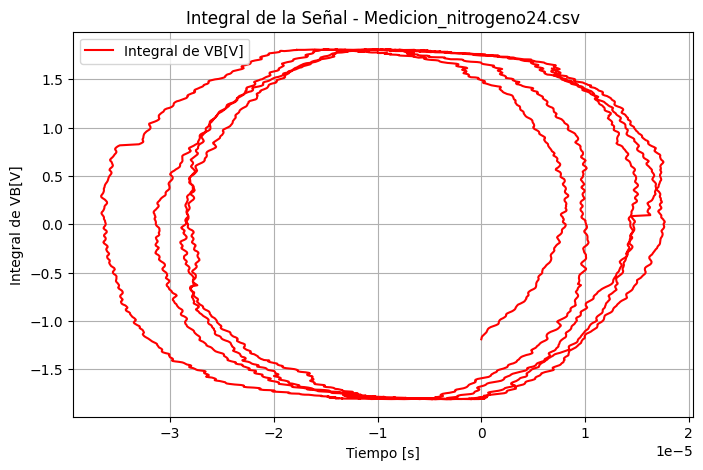

...

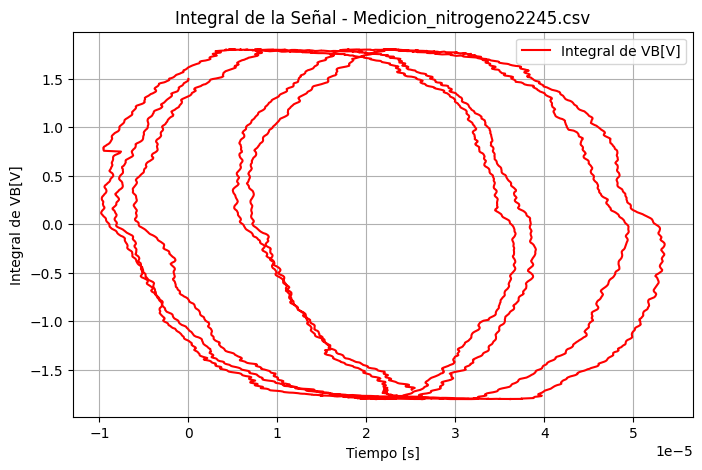

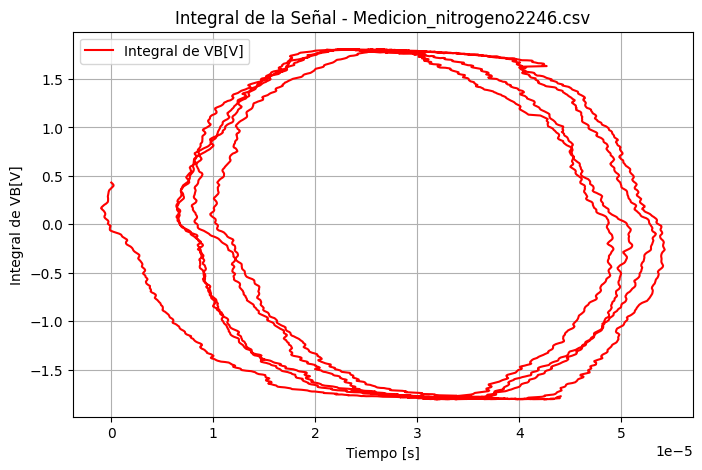

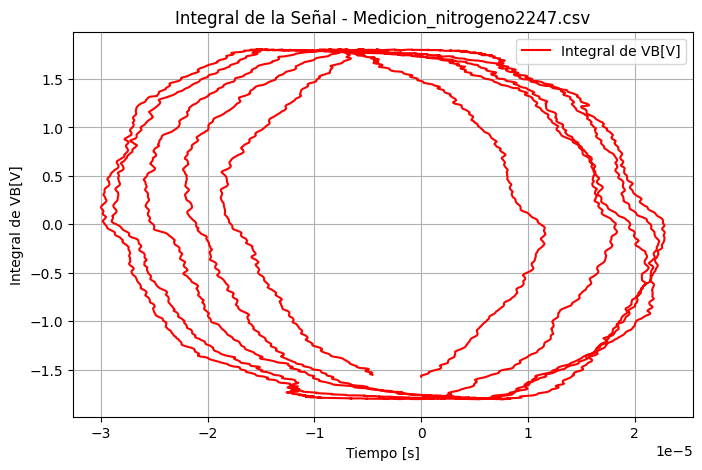

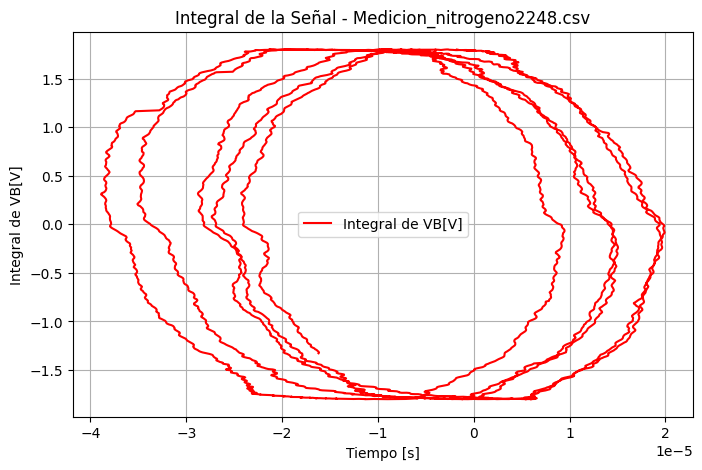

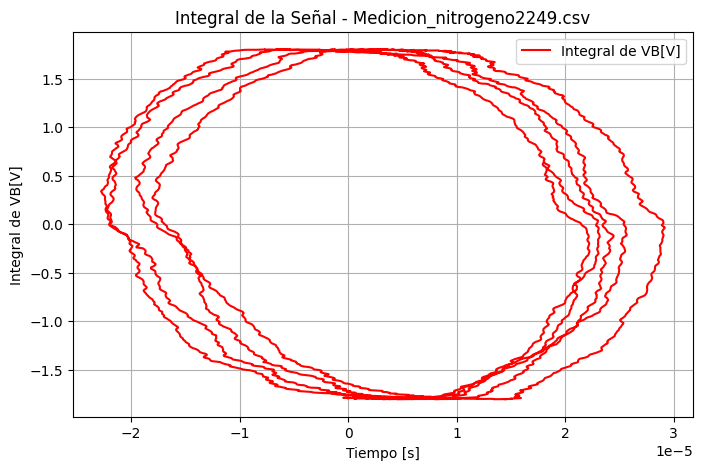

In [ ]:
from scipy.signal import find_peaks
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt

amplitudes = []
err_ampl = []

for csv_file in csv_files_sorted:
    file_path = os.path.join(folder_name, csv_file)

    df = pd.read_csv(file_path, header=0)
    df = df.dropna()
    df.columns = df.columns.str.strip()

    if '# Tiempo[s]' in df.columns and 'VB[V]' in df.columns and "V2[V]" in df.columns:
        tiempo = df["# Tiempo[s]"].values
        V2 = df["V2[V]"].values
        VB = df["VB[V]"].values

        # Integración
        dt = np.diff(tiempo)
        average_VB = (VB[:-1] + VB[1:]) / 2
        integral_signal = np.cumsum(average_VB * dt)
        integral_signal = np.insert(integral_signal, 0, 0)

        # Encontrar picos máximos y mínimos
        peaks, _ = find_peaks(integral_signal, distance=200, width=100)
        peak_max = integral_signal[peaks]

        peaks_abajo, _ = find_peaks(-integral_signal, distance=200, width=100)
        peak_min = integral_signal[peaks_abajo]

        # Seleccionar solo tres valores de cada lista
        num_peaks = 4  # Número de picos a tomar
        peak_max = peak_max[:num_peaks]  # Tomar los primeros tres picos máximos
        peak_min = peak_min[:num_peaks]  # Tomar los primeros tres picos mínimos

        # Verificar que ambas listas tengan al menos tres valores
        if len(peak_max) >= num_peaks and len(peak_min) >= num_peaks:
            amplitud = [(a - b)/2 for a, b in zip(peak_max, peak_min)]
            ample = np.mean(amplitud)
            err_ample = np.std(amplitud)

            amplitudes.append(ample)
            err_ampl.append(err_ample)



        # Graficación (opcional)
        plt.figure(figsize=(8, 5))
        plt.plot( integral_signal,V2, label="Integral de VB[V]", color='r')
        plt.xlabel("Tiempo [s]")
        plt.ylabel("Integral de VB[V]")
        plt.title(f"Integral de la Señal - {csv_file}")
        plt.legend()
        plt.grid()
        plt.show()


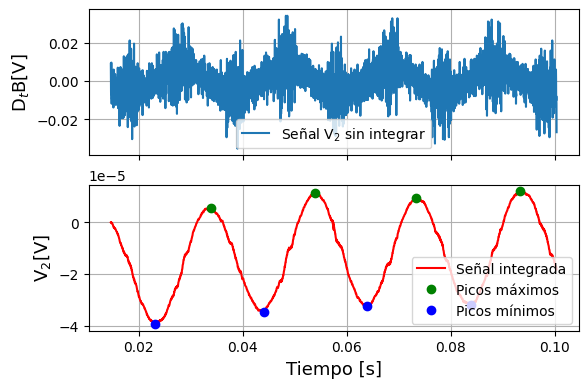

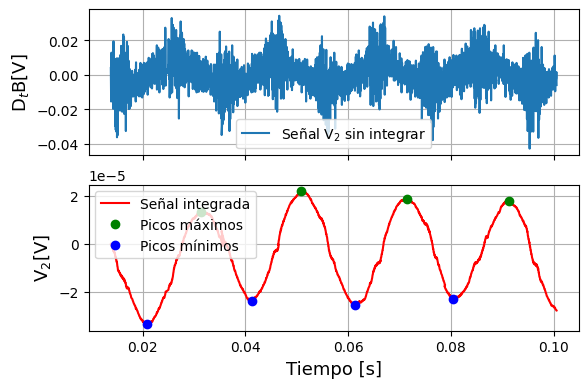

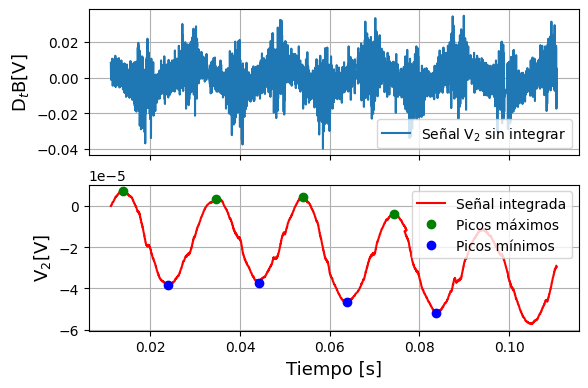

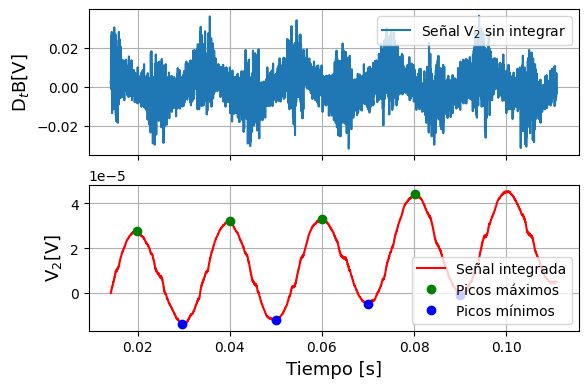

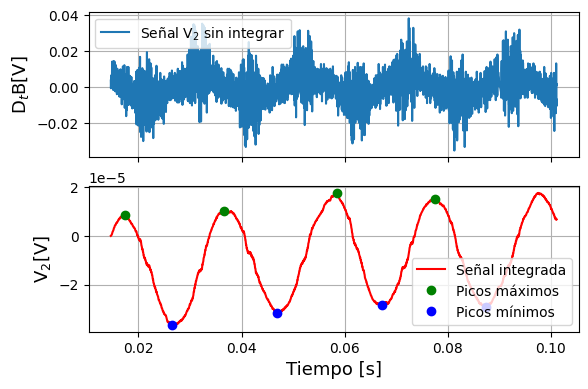

...

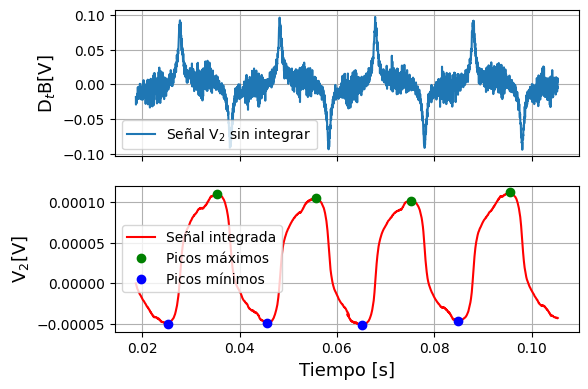

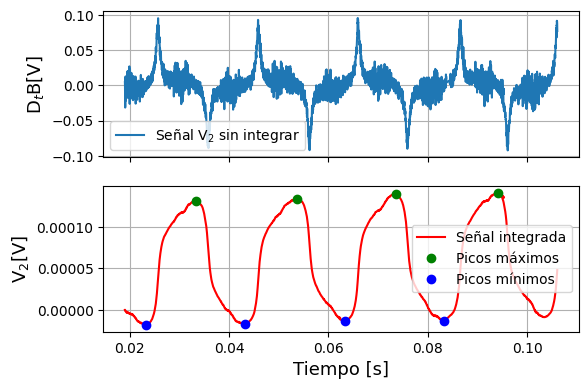

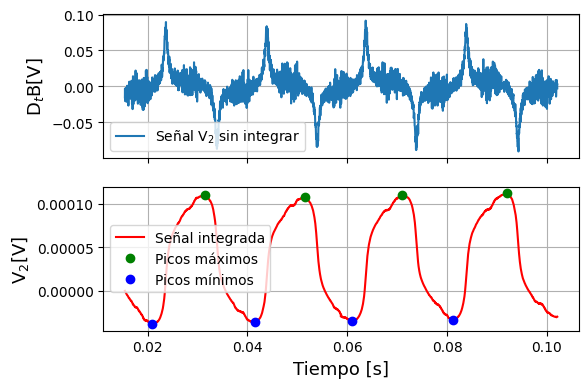

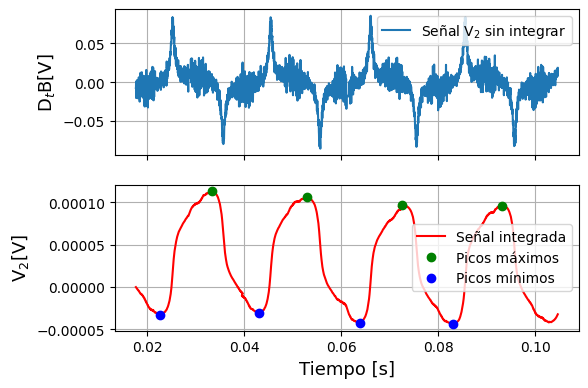

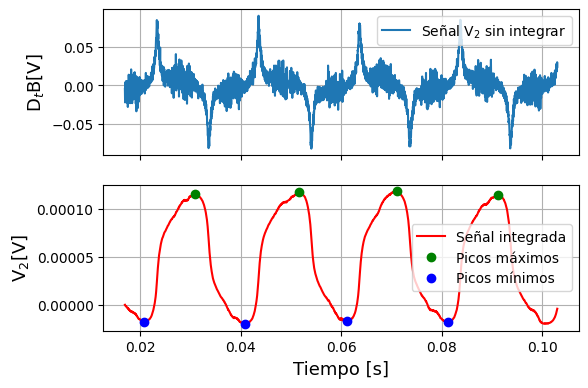

KeyboardInterrupt: 

In [ ]:
from scipy.signal import find_peaks
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt

amplitudes = []
err_ampl = []

for csv_file in csv_files_sorted:
    file_path = os.path.join(folder_name, csv_file)

    df = pd.read_csv(file_path, header=0)
    df = df.dropna()
    df.columns = df.columns.str.strip()

    if '# Tiempo[s]' in df.columns and 'VB[V]' in df.columns and "V2[V]" in df.columns:
        tiempo = df["# Tiempo[s]"].values
        V2 = df["V2[V]"].values
        VB = df["VB[V]"].values

        # Integración
        dt = np.diff(tiempo)
        average_VB = (VB[:-1] + VB[1:]) / 2
        integral_signal = np.cumsum(average_VB * dt)
        integral_signal = np.insert(integral_signal, 0, 0)

        # Encontrar picos máximos y mínimos
        peaks, _ = find_peaks(integral_signal, distance=200, width=100)
        peak_max = integral_signal[peaks]

        peaks_abajo, _ = find_peaks(-integral_signal, distance=200, width=100)
        peak_min = integral_signal[peaks_abajo]

        # Seleccionar solo tres valores de cada lista
        num_peaks = 4  # Número de picos a tomar
        peak_max = peak_max[:num_peaks]  # Tomar los primeros tres picos máximos
        peak_min = peak_min[:num_peaks]  # Tomar los primeros tres picos mínimos

        # Verificar que ambas listas tengan al menos tres valores
        if len(peak_max) >= num_peaks and len(peak_min) >= num_peaks:
            amplitud = [(a - b)/2 for a, b in zip(peak_max, peak_min)]
            ample = np.mean(amplitud)
            err_ample = np.std(amplitud)

            amplitudes.append(ample)
            err_ampl.append(err_ample)

        # Graficación (opcional)
        ig, ax = plt.subplots(2, 1, sharex=True, figsize=(6.8, 4.8))

        ax[0].plot(tiempo, VB, label="Señal V$_2$ sin integrar")
        ax[0].set_ylabel(r"D$_t$B[V]", fontsize=13)
        ax[0].grid()
        ax[0].legend()

        ax[1].plot(tiempo, integral_signal, label="Señal integrada", color='r')
        ax[1].plot(tiempo[peaks][:num_peaks], peak_max, "go", label="Picos máximos")
        ax[1].plot(tiempo[peaks_abajo][:num_peaks], peak_min, "bo", label="Picos mínimos")
        ax[1].set_xlabel("Tiempo [s]", fontsize=13)
        ax[1].set_ylabel(r"V$_2$[V]", fontsize=13)

        ax[1].legend()
        ax[1].grid()

        plt.tight_layout(pad=4.0)  # Ajusta el espacio entre gráficos (reduce 'pad' si es necesario)
        plt.subplots_adjust(hspace=0.2)  # Ajusta el espacio entre los subgráficos
        plt.show()


"""
# Resumen final
print("\nResumen final:")
for i, csv_file in enumerate(csv_files_sorted):
    print(f"Archivo: {csv_file}")
    print(f"Promedio: {amplitudes[i]}")
    print(f"Desviación estándar: {err_ampl[i]}")
    print("-" * 40)
"""

In [ ]:
R0 = 100 # [Ω]
err_R0 = 2
alpha = 0.00385 # coeficiente de temperatura del platino
Rs = 982.4 # [Ω]
fs = 5e4 # 50 kHz

err_V = 0.00032/2 # [V] -> Es el mismo error para todos los voltajes (si se usó la misma escala, -10 a 10 V)
err_Rs = 0.005*Rs + 8*0.1


In [ ]:
#@title Calculo de error del Rplat

"""
si quiero calcular el error de Rplat, recordar que el Rplat guardado se calculo como:

Rplat = (np.mean(Vplat)/np.mean(Vs))*Rs

Haciendo la propagacion de error quedaria:
term1 = (Rs / Vs_mean) * Vplat_std
term2 = (Rs * Vplat_mean / (Vs_mean**2)) * Vs_std
term3 = (Vplat_mean / Vs_mean) * err_Rs

err_Rplat = np.sqrt( (np.mean(Vplat)*err_Rs/np.mean(V1))**2 + (Rs*err_V/(np.mean))**2 + (Rs*np.mean(Vplat)*err_V /np.mean( V1)**2 )**2 )

"""

err_Rplat =[]
for csv_file in csv_files_sorted:
    file_path = os.path.join(folder_name, csv_file)

    df = pd.read_csv(file_path, header=0)
    df = df.dropna()
    dataframes[csv_file] = df
    df.columns = df.columns.str.strip()

    if "Vplat[V]" in df.columns and "Vs[V]" in df.columns:

      # Calcular media y desviación estándar
      Vplat_mean = np.mean(df["Vplat[V]"].values)
      Vplat_std = np.std(df["Vplat[V]"].values, ddof=1)

      Vs_mean = np.mean(df["Vs[V]"].values)
      Vs_std = np.std(df["Vs[V]"].values, ddof=1)


      term1 = (Rs / Vs_mean) * err_V
      term2 = (Rs * Vplat_mean / (Vs_mean**2)) * err_V
      term3 = (Vplat_mean / Vs_mean) * err_Rs

      err_f = np.sqrt(term1**2 + term2**2 + term3**2)
      err_Rplat.append(err_f)

print(err_Rplat)

[0.23942852657362412, 0.24803721590271838, 0.2403077915718133, 0.23861711698370755, 0.23957652984367914, 0.24115880765290407, 0.23851087586233713, 0.23748250541131294, 0.23869053859048348, 0.24034639881053727, 0.2363315233879867, 0.23663773689303585, 0.23598020314388, 0.2368526341092833, 0.2361978787889207, 0.23634215953962368, 0.23564743017446493, 0.23756695975949266, 0.23629902204449865, 0.23725883775197604, 0.2401560711245625, 0.2419104365820809, 0.23979775003236584, 0.23889173952819828, 0.24270177065178353, 0.24678098070588422, 0.2505105240245996, 0.2593013959502384, 0.2601213607605249, 0.2676503389363797, 0.2672008685317021, 0.2781059845472384, 0.2807736455370071, 0.28293952900388614, 0.28721326270312925, 0.29228294294972124, 0.290405896220512, 0.30218781399209965, 0.31329290794020515, 0.32911212566099973, 0.32485385700897784, 0.3134683778098897, 0.3174182906512113, 0.32080093440760454, 0.32243763921832597, 0.3265120774783135, 0.32977104796443224, 0.3321241330250937, 0.32860310588

In [ ]:
lista_Rplat = []

for csv_file in csv_files_sorted:
    file_path = os.path.join(folder_name, csv_file)

    df = pd.read_csv(file_path, header=0)
    df = df.dropna()  # Eliminar filas con valores NaN
    dataframes[csv_file] = df
    df.columns = df.columns.str.strip()  # Limpia nombres de columnas

    if "Rplat" in df.columns and not df["Rplat"].dropna().empty:
      lista_Rplat.append(df["Rplat"].dropna().iloc[0])  # Guarda solo el primer valor

print("len Rplat=", len(lista_Rplat))

len Rplat= 250


In [ ]:
lista_Rplat = np.array(lista_Rplat)
err_Rplat = np.array(err_Rplat)

temp = [(x - R0) / (alpha * R0) for x in lista_Rplat]
err_temp =[np.sqrt((err_p / (alpha * R0))**2 + (err_R0 * r / (alpha * R0**2))**2) for r, err_p in zip(lista_Rplat, err_Rplat)]

print("Temperatura=", temp[230])
print("Largo de temperattura=", len(temp))

#print("err temp=", err_temp)
#print("len err temp=", len(err_temp))

"""
plt.plot(temp,lista_Rplat, label="Resistencia de platino")
#plt.errorbar(temp, lista_Rplat, xerr =err_temp,yerr = err_Rplat ,fmt='o-', label="Resistencia de platino", capsize=3)
plt.ylabel('Resistencia [Ω]')
plt.xlabel('Temperatura [° C]')
plt.legend()
plt.grid()
"""

Temperatura= -2.8257991512374887
Largo de temperattura= 250


'   \nplt.plot(temp,lista_Rplat, label="Resistencia de platino")\n#plt.errorbar(temp, lista_Rplat, xerr =err_temp,yerr = err_Rplat ,fmt=\'o-\', label="Resistencia de platino", capsize=3)\nplt.ylabel(\'Resistencia [Ω]\')\nplt.xlabel(\'Temperatura [° C]\')\nplt.legend()\nplt.grid()\n'

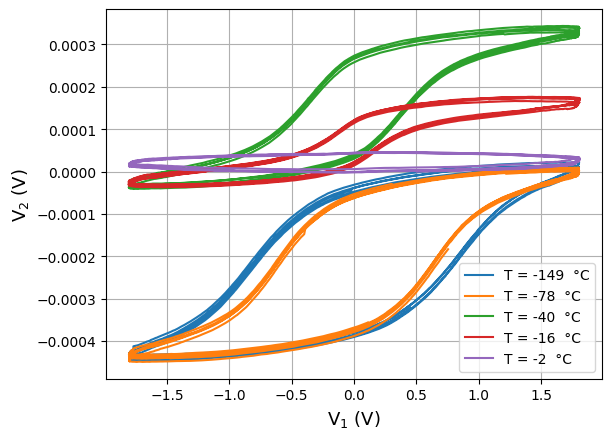

In [ ]:
#@title Histéresis

import matplotlib.cm as cm
import matplotlib.colors as mcolors

# Lista de mediciones para graficar la histéresis --> NO ELEGIR ANTES QUE 222
lista_mediciones = ['Medicion_nitrogeno243.csv', 'Medicion_nitrogeno287.csv', 'Medicion_nitrogeno2129.csv',
                    'Medicion_nitrogeno2178.csv', 'Medicion_nitrogeno2235.csv']

# Guardamos V1 y V2 para cada medición en una lista
lista_V1 = []
lista_V2 = []
labels_T = [] # Acá se guardarán los labels de las temperaturas
lista_err_V1 = [] # Para los errores en V1

for csv_file in lista_mediciones:
  file_path = os.path.join(folder_name, csv_file)

  df = pd.read_csv(file_path, header=0)
  df = df.dropna()
  df.columns = df.columns.str.strip()

  if '# Tiempo[s]' in df.columns and 'V1[V]' in df.columns:

    tiempo = df["# Tiempo[s]"].dropna().values
    VB = df["VB[V]"].dropna().values
    V2 = df["V2[V]"].dropna().values

    dt = np.diff(tiempo)
    average_VB = (VB[:-1] + VB[1:]) / 2
    integral_signal = np.cumsum(average_VB * dt)
    integral_signal = np.insert(integral_signal, 0, 0)

    lista_V1.append(integral_signal)
    lista_V2.append(V2)

  # Extrae la temperatura correspondiente al archivo:
  indice = csv_files_sorted.index(csv_file)
  labels_T.append(f"T = {temp[indice]:.0f}  °C")  # Y la guarda como label

  # Errores:
  lista_err_V1.append(err_ampl[indice]) # [V] -> Este sale de calcular las amplitudes
  err_V2 = 0.00032/2 # [V] -> Este es el de resolución instrumental



# Grafica

for i, (V1, V2) in enumerate(zip(lista_V1, lista_V2)):

  plt.plot(V2, -V1, '-', label=labels_T[i])
plt.legend(loc='lower right', fontsize=10)
plt.xlabel(r'V$_1$ (V)', fontsize=13)
plt.ylabel(r'V$_2$ (V)', fontsize=13)
plt.grid()
plt.show()

In [ ]:
ult_dat = -51
pri_dat = 90

t = temp[pri_dat:ult_dat]
ampl = amplitudes[pri_dat:ult_dat]

err_temp = err_temp[pri_dat:ult_dat]
err_VB = err_ampl[pri_dat:ult_dat]


ampl = np.array(ampl)
t = np.array(t)
err_VB = np.array(err_VB)



print("len ample", len(ampl))
print("len temp", len(t))
print("len err VB", len(err_VB))
print("len err t", len(err_temp))

len ample 109
len temp 109
len err VB 109
len err t 109


Valores con errores:
 Tc=(-11.11431875808608 ± 1.2786534041325175)°C,
 B=0.26720986109814704 ± 0.019283344752846293,
 A=(7.421385891298356e-05 ± 5.915875777635248e-06)[a.u.]

Chi²= 19122.900059195046
Chi² reducido= 180.4047175395759



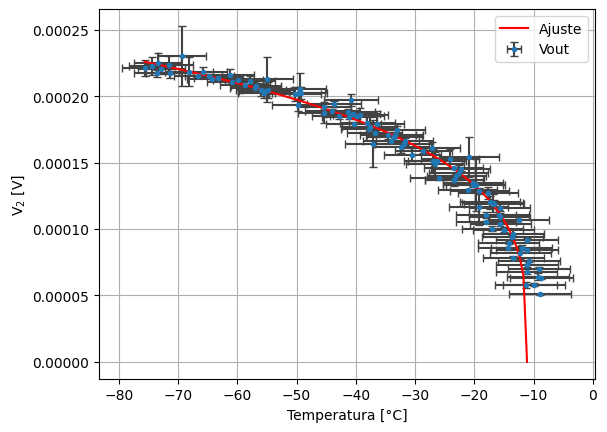

In [ ]:
from scipy.odr import ODR, Model, RealData

# Modelo corregido: T < Tc, Ms ~ (Tc - T)^B
def modelo_odr(beta, t):
    Tc, B, A = beta
    te = (t - Tc)
    return A * (np.abs(te)) ** B

p0 = [25, 0.4, .009]

data = RealData(t, ampl,sx=err_temp, sy=err_VB)
odr_model = Model(modelo_odr)
odr = ODR(data, odr_model, beta0=p0)

# Ejecutar el ajuste
output = odr.run()

# Extraer parámetros optimizados y sus errores
Tc_opt, B_opt, A_opt = output.beta
Tc_err, B_err, A_err = np.sqrt(np.diag(output.cov_beta))

# Imprimir resultados
print(f"Valores con errores:\n Tc=({Tc_opt} ± {Tc_err})°C,\n B={B_opt} ± {B_err},\n A=({A_opt} ± {A_err})[a.u.]")
print()

# Generar curva ajustada (solo para T < Tc)
t_fit = np.linspace(np.min(t), Tc_opt, len(t))
y_fit = modelo_odr([Tc_opt, B_opt, A_opt], t_fit)

# Cálculo de χ² y χ²reducido:
chi2 = np.sum((ampl - modelo_odr([Tc_opt, B_opt, A_opt], t))**2 / err_VB**2)
print("Chi²=", chi2)

chi2_red = chi2 / (len(t) - len(output.beta)) # χ²/(N-p)
print("Chi² reducido=", chi2_red) # >1 -> sobre-ajuste; <1 -> subajuste; =1 -> ajuste perfecto


print()
# Graficar

plt.errorbar(t, ampl, xerr=err_temp, yerr=err_VB, fmt=".", ecolor="grey", label=r"V$_1$", capsize=3, alpha=0.5)
plt.plot(t_fit, y_fit, label="Ajuste", color='red')
plt.xlabel("Temperatura [°C]", fontsize=13)
plt.ylabel(r"V$_2$ [V]", fontsize=13)
plt.legend()
plt.grid()
plt.show()




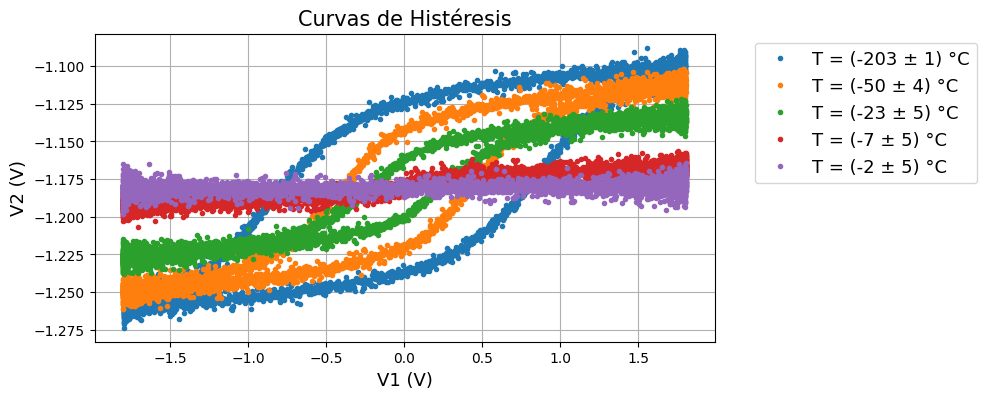

In [ ]:
#@title Histéresis

# Lista de mediciones para graficar la histéresis --> NO ELEGIR ANTES QUE 222
lista_mediciones = ['Medicion_nitrogeno222.csv', 'Medicion_nitrogeno2120.csv', 'Medicion_nitrogeno2160.csv',
                    'Medicion_nitrogeno2200.csv', 'Medicion_nitrogeno2235.csv']

# Guardamos V1 y V2 para cada medición en una lista
lista_V1 = []
lista_V2 = []
labels_T = [] # Acá se guardarán los labels de las temperaturas
lista_err_V1 = [] # Para los errores en V1

for csv_file in lista_mediciones:
  file_path = os.path.join(folder_name, csv_file)

  df = pd.read_csv(file_path, header=0)
  df = df.dropna()
  df.columns = df.columns.str.strip()

  if '# Tiempo[s]' in df.columns and 'V1[V]' in df.columns:

    tiempo = df["# Tiempo[s]"].dropna().values
    V1 = df["V1[V]"].dropna().values
    V2 = df["V2[V]"].dropna().values


    lista_V1.append(V1)
    lista_V2.append(V2)

  # Extrae la temperatura correspondiente al archivo:
  indice = csv_files_sorted.index(csv_file)
  labels_T.append(f"T = ({temp[indice]:.0f} ± {err_temp[indice]:.0f}) °C")  # Y la guarda como label

  # Errores:
  lista_err_V1.append(err_ampl[indice]) # [V] -> Este sale de calcular las amplitudes
  err_V2 = 0.00032/2 # [V] -> Este es el de resolución instrumental

# Grafica
plt.figure(figsize=(8, 4))
for i, (V1, V2) in enumerate(zip(lista_V1, lista_V2)): # i es el índice (dado por enumerate)
  # plt.errorbar(V1, V2, yerr=err_V2, xerr=lista_err_V1[i], fmt='.', label=labels_T[i]) # Plotea cada V2(V1) según las mediciones elegidas con lista_mediciones
  plt.plot(V2, V1, '.', label=labels_T[i]) # Plotea cada V2(V1) según las mediciones elegidas con lista_mediciones
plt.legend(bbox_to_anchor=(1.05, 1), fontsize=13)
plt.title('Curvas de Histéresis', fontsize=15)
plt.xlabel('V1 (V)', fontsize=13)
plt.ylabel('V2 (V)', fontsize=13)
plt.grid()
plt.show()

# **Basurero**

In [ ]:

"""
amplitudes = []

for csv_file in csv_files_sorted:
    file_path = os.path.join(folder_name, csv_file)

    df = pd.read_csv(file_path, header=0)
    df = df.dropna()  # Eliminar filas con valores NaN
    dataframes[csv_file] = df  # Almacenar el DataFrame en el diccionario
    df.columns = df.columns.str.strip()  # Limpia nombres de columnas

    fs = 1000  # frecuencia de muestreo
    cutoff = 10

    if '# Tiempo[s]' in df.columns and 'VB[V]' in df.columns and "V2[V]" in df.columns:
      tiempo = df["# Tiempo[s]"].values
      V2 = df["V2[V]"].values
      VB = df["VB[V]"].values
      signal = VB

      filtered_signal = butter_lowpass_filter(signal, cutoff, fs)



      integral_signal = cumulative_trapezoid(filtered_signal, tiempo)
      tiempo_integral = tiempo[1:]




      #print("ARCHIVO :",csv_file)
      plt.figure(figsize=(8, 5))
      plt.plot(tiempo_integral, integral_signal, label="Integral de VB[V]", color='r')
      plt.xlabel("Tiempo [s]")
      plt.ylabel("Integral de VB[V]")
      plt.title(f"Integral de la Señal - {csv_file}")
      plt.legend()
      plt.grid()


      amplitud = np.max(integral_signal) - np.min(integral_signal)
      amplitudes.append(amplitud)

print("lista de amplitudes=", len(amplitudes))

#print(len(integral_signal))
"""

'\namplitudes = []\n\nfor csv_file in csv_files_sorted:\n    file_path = os.path.join(folder_name, csv_file)\n\n    df = pd.read_csv(file_path, header=0)\n    df = df.dropna()  # Eliminar filas con valores NaN\n    dataframes[csv_file] = df  # Almacenar el DataFrame en el diccionario\n    df.columns = df.columns.str.strip()  # Limpia nombres de columnas\n\n    fs = 1000  # frecuencia de muestreo\n    cutoff = 10\n\n    if \'# Tiempo[s]\' in df.columns and \'VB[V]\' in df.columns and "V2[V]" in df.columns:\n      tiempo = df["# Tiempo[s]"].values\n      V2 = df["V2[V]"].values\n      VB = df["VB[V]"].values\n      signal = VB\n\n      filtered_signal = butter_lowpass_filter(signal, cutoff, fs)\n\n\n\n      integral_signal = cumulative_trapezoid(filtered_signal, tiempo)\n      tiempo_integral = tiempo[1:]\n\n\n\n\n      #print("ARCHIVO :",csv_file)\n      plt.figure(figsize=(8, 5))\n      plt.plot(tiempo_integral, integral_signal, label="Integral de VB[V]", color=\'r\')\n      plt.xlabel

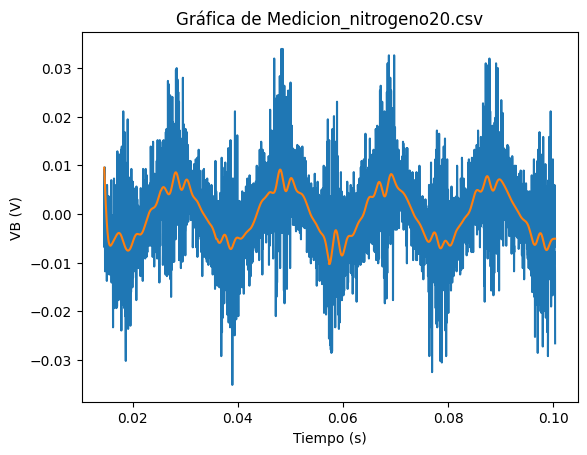

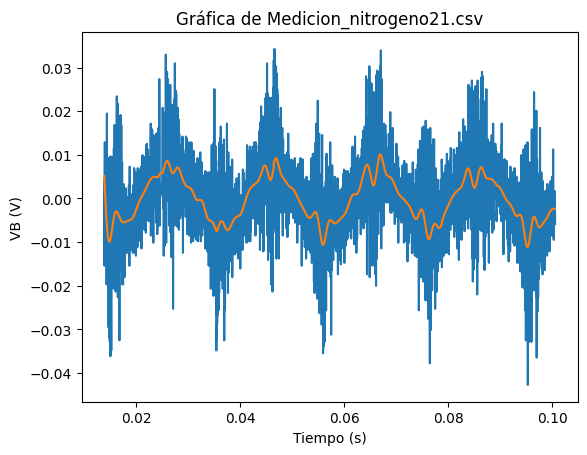

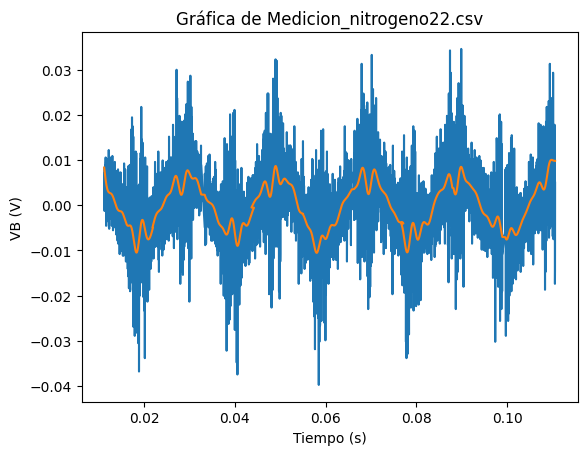

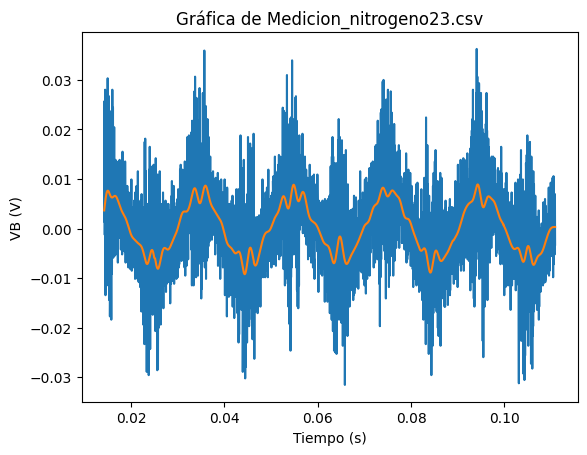

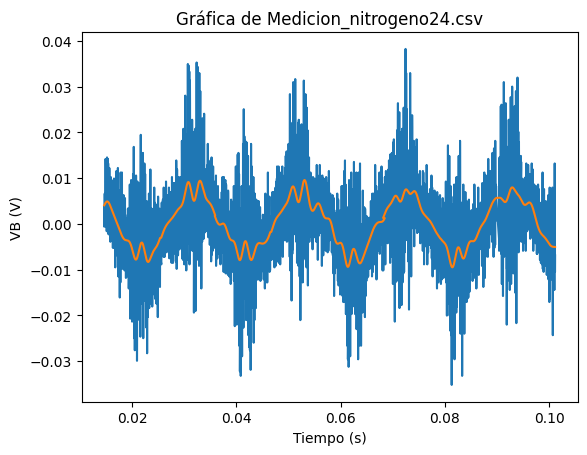

...

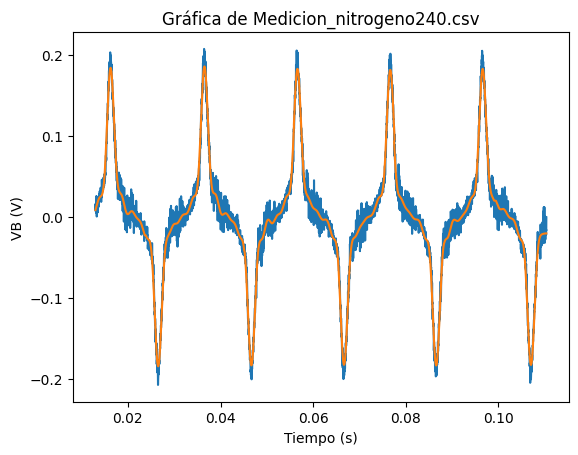

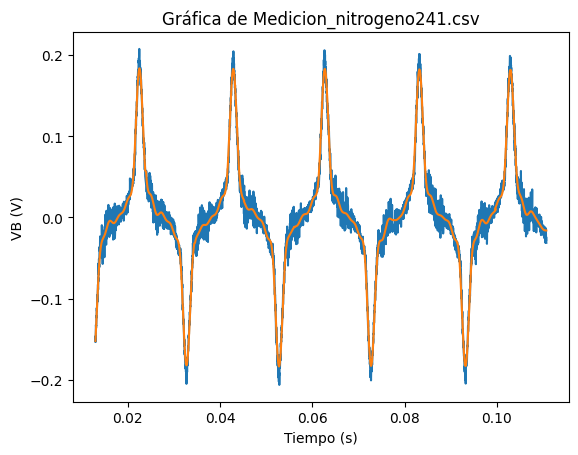

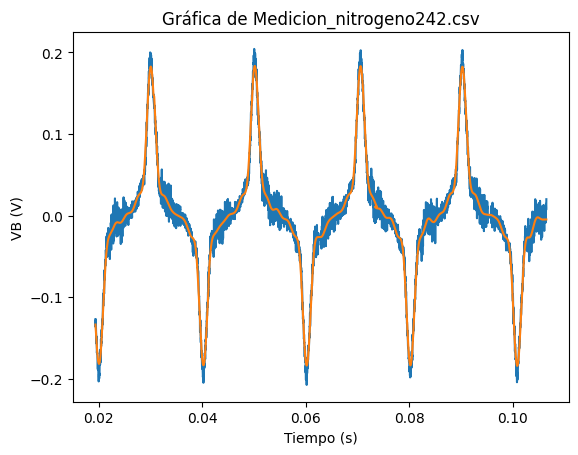

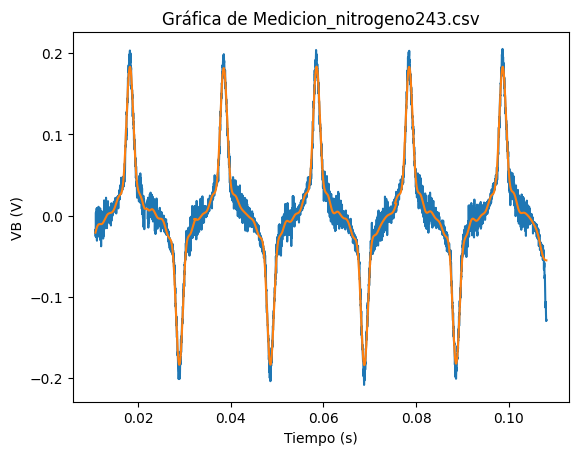

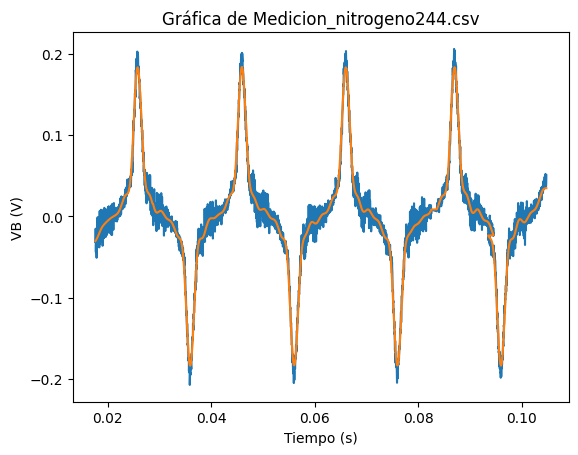

KeyboardInterrupt: 

In [ ]:

"""
#@title Acá podes ver la señal antes del integrador y un promedio superpuesto

for csv_file in csv_files_sorted:

  file_path = os.path.join(folder_name, csv_file)

  df = pd.read_csv(file_path, header=0)
  df = df.dropna()  # Eliminar filas con valores NaN
  dataframes[csv_file] = df  # Almacenar el DataFrame en el diccionario
  df.columns = df.columns.str.strip()  # Limpia nombres de columnas

  fs = 1000  # frecuencia de muestreo
  cutoff = 10

  if '# Tiempo[s]' in df.columns and 'VB[V]' in df.columns and "V2[V]" in df.columns:
    tiempo = df["# Tiempo[s]"].values
    V2 = df["V2[V]"].values
    VB = df["VB[V]"].values
    signal = VB

    filtered_signal = butter_lowpass_filter(signal, cutoff, fs)


    plt.plot(tiempo, VB)
    plt.plot(tiempo, filtered_signal)
    plt.xlabel("Tiempo (s)")
    plt.ylabel("VB (V)")
    plt.title(f"Gráfica de {csv_file}")
    plt.show()

"""

In [ ]:
"""
from scipy.signal import butter, filtfilt

# 1. Filtrar la señal (filtro pasa-bajo)
def butter_lowpass(cutoff, fs, order=5):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

def butter_lowpass_filter(data, cutoff, fs, order=5):
    b, a = butter_lowpass(cutoff, fs, order)
    y = filtfilt(b, a, data)
    return y

"""

In [ ]:
#@title Acá podes ver la señal antes del integrador y un promedio superpuesto

"""
from scipy.signal import savgol_filter

for csv_file in csv_files_sorted:

  file_path = os.path.join(folder_name, csv_file)

  df = pd.read_csv(file_path, header=0)
  df = df.dropna()  # Eliminar filas con valores NaN
  dataframes[csv_file] = df  # Almacenar el DataFrame en el diccionario
  df.columns = df.columns.str.strip()  # Limpia nombres de columnas



  if '# Tiempo[s]' in df.columns and 'VB[V]' in df.columns and "V2[V]" in df.columns:
    tiempo = df["# Tiempo[s]"].values
    V2 = df["V2[V]"].values
    VB = df["VB[V]"].values
    signal = VB

    filtered_signal = savgol_filter(signal, window_length=13, polyorder=3)


    plt.plot(tiempo, VB)
    plt.plot(tiempo, filtered_signal)
    plt.xlabel("Tiempo (s)")
    plt.ylabel("VB (V)")
    plt.title(f"Gráfica de {csv_file}")
    plt.show()
"""